In [1]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

from backTester.BackTester import BackTester

In [17]:
backdata = pd.read_pickle("C:\\TIL\\AutoTrader\\BinanceTrader\\backdata.pkl")

bt = BackTester()

window1 = 20
window2 = 10
backdata['MA'] = bt.get_MA(window1, backdata['Close'])
backdata['std'] = bt.get_std(window1, backdata['Close'])
backdata['UB'] = backdata['MA'] + 2 * backdata['std']
backdata['U75'] = backdata['MA'] + backdata['std']
backdata['LB'] = backdata['MA'] - 2 * backdata['std']
backdata['L25'] = backdata['MA'] - backdata['std']
backdata['ER'] = backdata['Close'].diff(window2).abs()/backdata['Close'].diff().abs().rolling(window2).sum()

backdata['ERmean'] = backdata['ER'].mean()*1.5

In [18]:
num_parts = 20 # change if you want.
n = backdata.shape[0]//num_parts
datadict = dict()
for k in range(num_parts):
    if k==num_parts-1:
        datadict[f'd{k}'] = backdata[n*k:]
    else:
        datadict[f'd{k}'] = backdata[n*k:n*(k+1)]

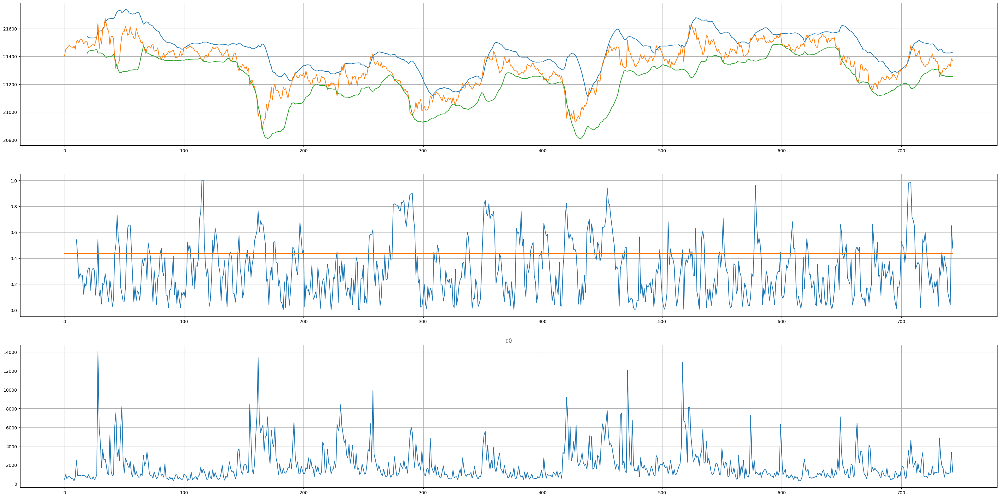

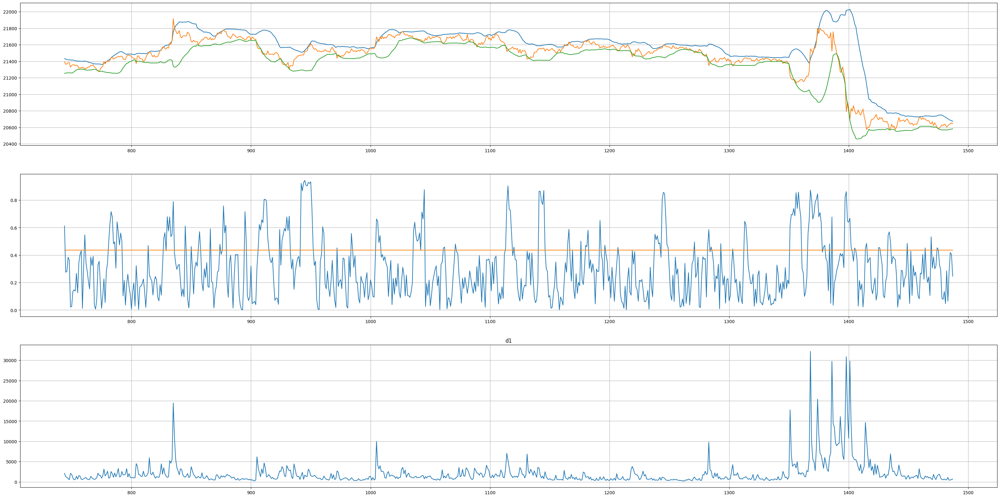

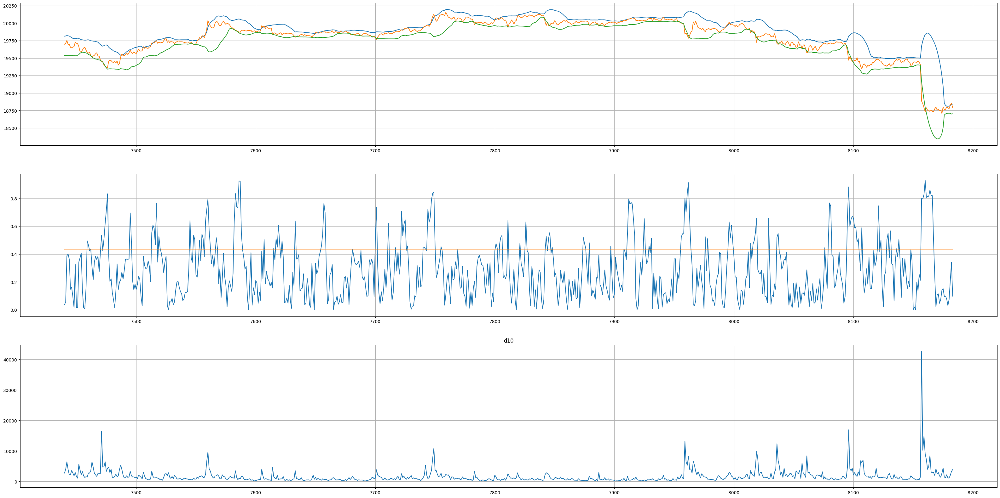

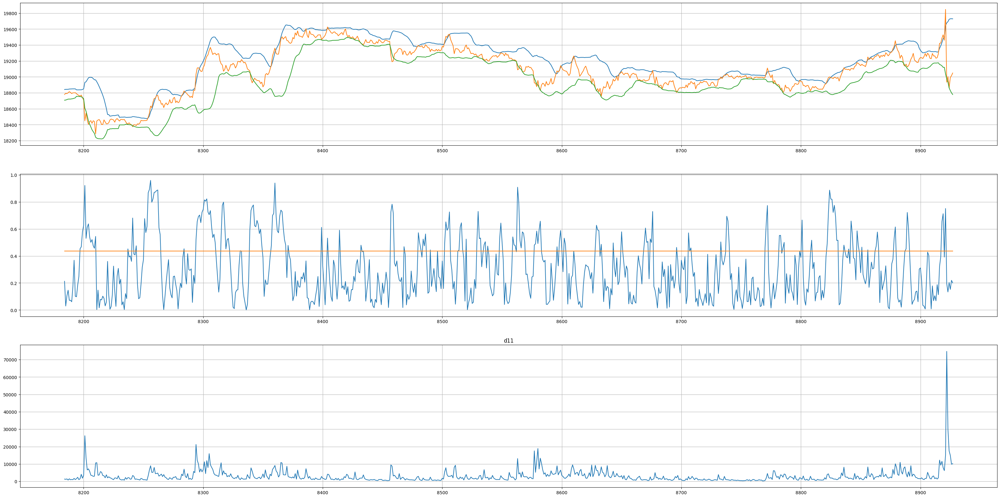

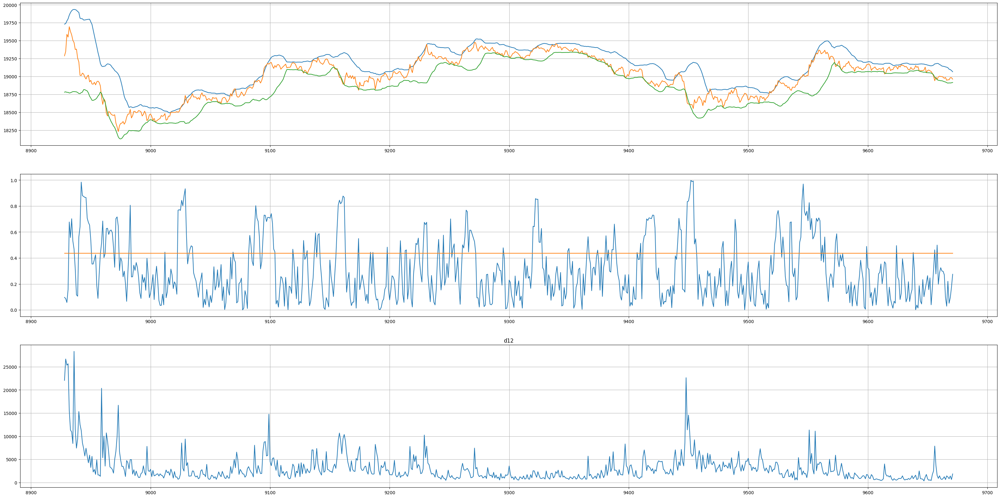

...

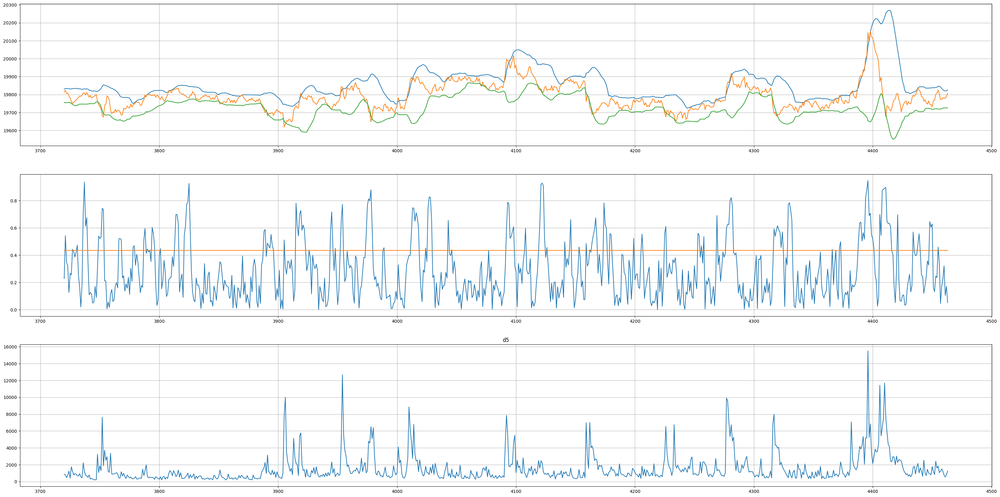

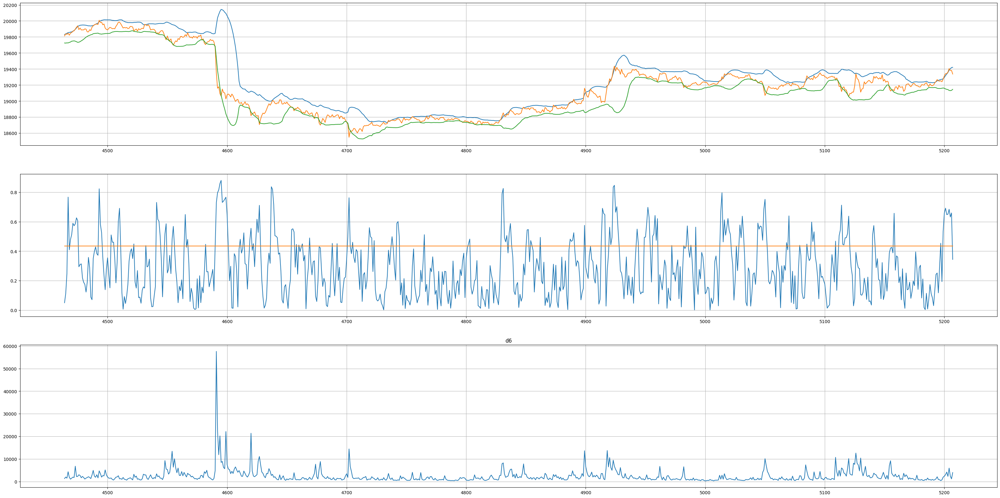

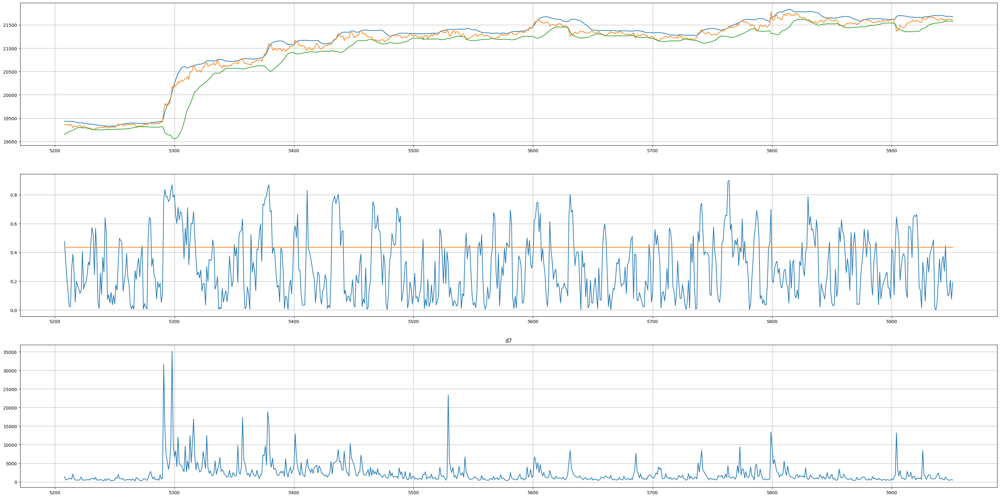

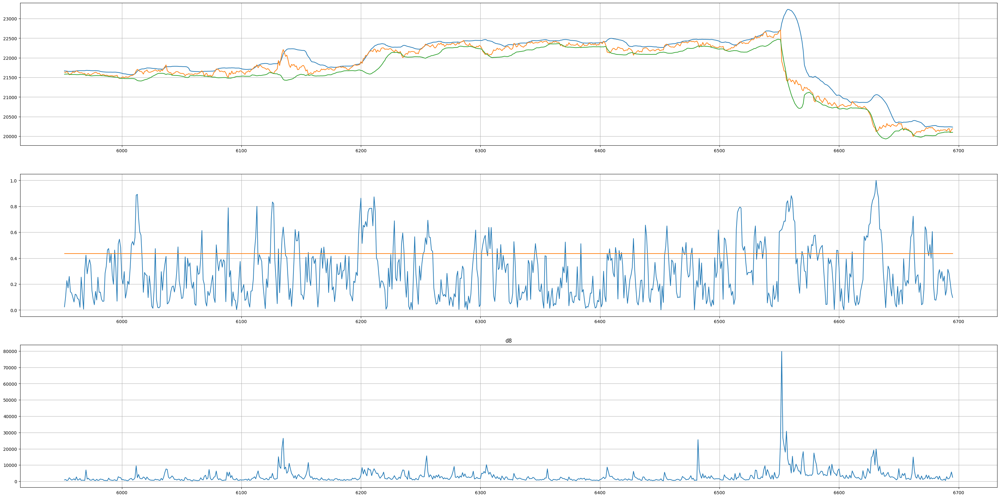

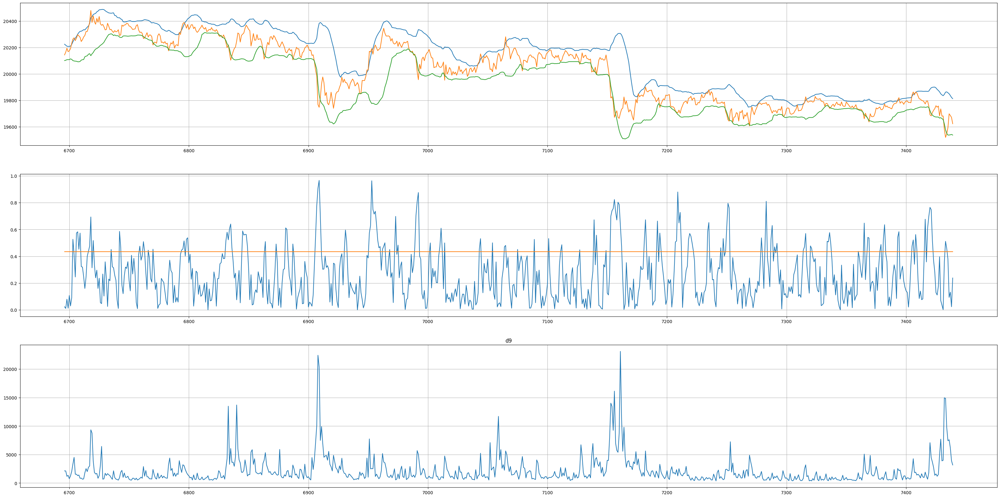

In [26]:
for data_key in sorted(datadict.keys()):
    data = datadict[data_key]
    fig = plt.figure(figsize=(40, 20))
    ax1 = fig.add_subplot(3, 1, 1)
    ax2 = fig.add_subplot(3, 1, 2)
    ax3 = fig.add_subplot(3, 1, 3)
    ax1.plot(data[['UB', 'Close', 'LB']])
    ax1.grid()
    plt.title(data_key)
    ax2.plot(data[['ER', 'ERmean']])
    ax2.grid()
    ax3.plot(data['Volume'])
    ax3.grid()
    plt.show()

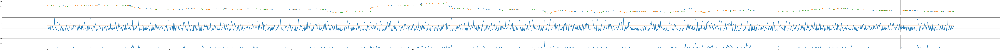

In [28]:
fig = plt.figure(figsize=(400, 20))
ax1 = fig.add_subplot(3, 1, 1)
ax2 = fig.add_subplot(3, 1, 2)
ax3 = fig.add_subplot(3, 1, 3)
ax1.plot(backdata[['UB', 'Close', 'LB']])
ax1.grid()
plt.title(data_key)
ax2.plot(backdata[['ER', 'ERmean']])
ax2.grid()
ax3.plot(backdata['Volume'])
ax3.grid()
plt.show()